<a href="https://colab.research.google.com/github/cindyzakya/AI-ML-Final-Project-Fraud-Detection-on-AirBnB-Listing/blob/main/AI%26ML%20Final%20Project-Fraud%20Detection%20on%20AirBnB%20Listing.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
# Import libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout


In [3]:
# Import modul files dari Google Colab untuk menangani file
from google.colab import files
# Upload file dari komputer ke Google Colab.
files.upload()

Saving Airbnb_Open_Data.csv to Airbnb_Open_Data.csv


{'Airbnb_Open_Data.csv': b'id,NAME,host id,host_identity_verified,host name,neighbourhood group,neighbourhood,lat,long,country,country code,instant_bookable,cancellation_policy,room type,Construction year,price,service fee,minimum nights,number of reviews,last review,reviews per month,review rate number,calculated host listings count,availability 365,house_rules,license\r\n1001254,Clean & quiet apt home by the park,80014485718,unconfirmed,Madaline,Brooklyn,Kensington,40.64749,-73.97237,United States,US,FALSE,strict,Private room,2020,$966 ,$193 ,10,9,10/19/2021,0.21,4,6,286,Clean up and treat the home the way you\'d like your home to be treated.  No smoking.,\r\n1002102,Skylit Midtown Castle,52335172823,verified,Jenna,Manhattan,Midtown,40.75362,-73.98377,United States,US,FALSE,moderate,Entire home/apt,2007,$142 ,$28 ,30,45,5/21/2022,0.38,4,2,228,Pet friendly but please confirm with me if the pet you are planning on bringing with you is OK. I have a cute and quiet mixed chihuahua. I coul

In [20]:
# Membaca file CSV Airbnb_Open_Data.csv
airbnb_dataset = pd.read_csv('Airbnb_Open_Data.csv')

# Menghapus kolom yang tidak diperlukan
airbnb_dataset = airbnb_dataset.drop(columns=['id', 'host id', 'lat', 'long', 'country', 'country code', 'instant_bookable', 'cancellation_policy', 'minimum nights', 'calculated host listings count', 'house_rules', 'license'])

# Menghapus baris dengan missing value pada kolom penting
important_coulmns = ['NAME', 'host name', 'host_identity_verified', 'neighbourhood group', 'neighbourhood', 'Construction year', 'price', 'service fee', 'number of reviews', 'last review', 'reviews per month', 'review rate number', 'availability 365']
airbnb_dataset.dropna(subset=important_coulmns, inplace=True)

# Menghapus baris yang duplikat
airbnb_dataset.drop_duplicates(inplace=True)

# Mengubah tipe data kolom 'price' dan 'service fee' menjadi numerik
airbnb_dataset['price'] = pd.to_numeric(airbnb_dataset['price'].str.replace('[\$,]', '', regex=True), errors='coerce')
airbnb_dataset['service fee'] = pd.to_numeric(airbnb_dataset['service fee'].str.replace('[\$,]', '', regex=True), errors='coerce')

/tmp/ipython-input-20-3357474919.py:2: DtypeWarning: Columns (25) have mixed types. Specify dtype option on import or set low_memory=False.
  airbnb_dataset = pd.read_csv('Airbnb_Open_Data.csv')


In [21]:
# Mengelompokkan construction year ke dalam 1 periode yang sama setiap 3 tahun berdasarkan tahun 2003 sebagai titik awal
airbnb_dataset['construction_period'] = ((airbnb_dataset['Construction year'] - 2003) // 3) + 1

In [22]:
# Menghitung rata-rata harga untuk setiap cluster
price_cluster_means = airbnb_dataset.groupby(['neighbourhood group', 'room type', 'construction_period'])['price'].mean().reset_index()
service_fee_cluster_means = airbnb_dataset.groupby(['neighbourhood group', 'room type', 'construction_period'])['service fee'].mean().reset_index()

# Melakukan merge untuk menambahkan kolom 'price_cluster_means' dan 'service_fee_cluster_means' ke DataFrame
airbnb_dataset = airbnb_dataset.merge(price_cluster_means, on=['neighbourhood group', 'room type', 'construction_period'], how='left')
airbnb_dataset = airbnb_dataset.merge(service_fee_cluster_means, on=['neighbourhood group', 'room type', 'construction_period'], how='left')

In [23]:
# Menentukan batas normal
def detect_abnormal_price(row):
    if row['price_x'] < 0.7 * row['price_y'] or row['price_x'] > 1.3 * row['price_y']:
        return 1  # Indikasi penipuan
    return 0  # Harga normal

def detect_abnormal_service_fee(row):
    if row['service fee_x'] < 0.7 * row['service fee_y'] or row['service fee_x'] > 1.3 * row['service fee_y']:
        return 1  # Indikasi penipuan
    return 0  # Service fee normal

airbnb_dataset['is_abnormal_price'] = airbnb_dataset.apply(detect_abnormal_price, axis=1)
airbnb_dataset['is_abnormal_service_fee'] = airbnb_dataset.apply(detect_abnormal_service_fee, axis=1)

In [24]:
#Indikasi Penipuan Lain
# Indikasi 1: Properti dengan 'availability_365' = 365 tetapi 'number_of_reviews' rendah
# Misalnya,properti dengan kurang dari 10 ulasan namun tersedia sepanjang tahun sebagai indikasi penipuan
airbnb_dataset['suspicious 1'] = ((airbnb_dataset['availability 365'] == 365) & (airbnb_dataset['number of reviews'] < 10)).astype(int)

# Indikasi 2: Properti dengan 'review rate number' konsisten tinggi tetapi 'number_of_reviews' dan 'reviews per month' rendah
# Misalnya, properti dengan 'review rate number' = 5, 'reviews per month' <=1, dan 'number_of_reviews' < 10
airbnb_dataset['suspicious 2'] = ((airbnb_dataset['review rate number'] == 5) & (airbnb_dataset['reviews per month'] <= 1) & (airbnb_dataset['number of reviews'] < 10)).astype(int)

# Indikasi 3: Host belum terverifikasi
# Mengubah nilai kolom host_identity_verified menjadi 1 dan 0
airbnb_dataset['host_identity_verified'] = airbnb_dataset['host_identity_verified'].apply(
    lambda x: 1 if x == 'unconfirmed' else 0
)


In [25]:
# Menambahkan kolom 'is_fraud' berdasarkan kondisi
def detect_fraud(row):
    suspicious_columns = ['is_abnormal_price', 'is_abnormal_service_fee', 'suspicious 1', 'suspicious 2', 'host_identity_verified']
    if row[suspicious_columns].sum() > 3:
        return 1  # Indikasi penipuan
    return 0  # Tidak ada indikasi penipuan

# Menambahkan kolom 'is_fraud' ke dataset
airbnb_dataset['is_fraud'] = airbnb_dataset.apply(detect_fraud, axis=1)

In [26]:
airbnb_dataset.head()

,NAME,host_identity_verified,host name,neighbourhood group,neighbourhood,room type,Construction year,price_x,service fee_x,number of reviews,...,review rate number,availability 365,construction_period,price_y,service fee_y,is_abnormal_price,is_abnormal_service_fee,suspicious 1,suspicious 2,is_fraud
0,Clean & quiet apt home by the park,1,Madaline,Brooklyn,Kensington,Private room,2020.0,966,193,9.0,...,4.0,286.0,6.0,608.267150,121.641546,1,1,0,0,0
1,Skylit Midtown Castle,0,Jenna,Manhattan,Midtown,Entire home/apt,2007.0,142,28,45.0,...,4.0,228.0,2.0,630.781399,126.162212,1,1,0,0,0
2,Entire Apt: Spacious Studio/Loft by central park,0,Lyndon,Manhattan,East Harlem,Entire home/apt,2009.0,204,41,9.0,...,3.0,289.0,3.0,619.734640,123.949491,1,1,0,0,0
3,Large Cozy 1 BR Apartment In Midtown East,0,Michelle,Manhattan,Murray Hill,Entire home/apt,2013.0,577,115,74.0,...,3.0,374.0,4.0,627.277586,125.458670,0,0,0,0,0
4,BlissArtsSpace!,1,Emma,Brooklyn,Bedford-Stuyvesant,Private room,2009.0,1060,212,49.0,...,5.0,219.0,3.0,621.360020,124.282417,1,1,0,0,0


In [27]:
# Memisahkan fitur (X) dan target (y)
X = airbnb_dataset.drop(columns=['is_fraud', 'NAME', 'host_identity_verified', 'host name', 'neighbourhood group', 'neighbourhood', 'room type', 'last review'])
y = airbnb_dataset['is_fraud']

In [28]:
# Membagi dataset menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [29]:
# Normalisasi data
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

In [30]:
# Membangun Model Neural Network
model = Sequential([
    Dense(128, activation='relu', input_shape=(X_train.shape[1],)),
    Dropout(0.3),
    Dense(64, activation='relu'),
    Dropout(0.2),
    Dense(32, activation='relu'),
    Dense(1, activation='sigmoid')
])

model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [31]:
# Training Model
history = model.fit(X_train, y_train, epochs=50, batch_size=32, validation_split=0.2)

Epoch 1/50
1414/1414 ━━━━━━━━━━━━━━━━━━━━ 9s 5ms/step - accuracy: 0.9596 - loss: 0.0994 - val_accuracy: 0.9677 - val_loss: 0.0460
Epoch 2/50
1414/1414 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - accuracy: 0.9671 - loss: 0.0478 - val_accuracy: 0.9663 - val_loss: 0.0452
Epoch 3/50
1414/1414 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - accuracy: 0.9681 - loss: 0.0451 - val_accuracy: 0.9673 - val_loss: 0.0453
Epoch 4/50
1414/1414 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - accuracy: 0.9683 - loss: 0.0468 - val_accuracy: 0.9683 - val_loss: 0.0447
Epoch 5/50
1414/1414 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - accuracy: 0.9681 - loss: 0.0451 - val_accuracy: 0.9690 - val_loss: 0.0443
Epoch 6/50
1414/1414 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - accuracy: 0.9688 - loss: 0.0440 - val_accuracy: 0.9689 - val_loss: 0.0443
Epoch 7/50
1414/1414 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - accuracy: 0.9690 - loss: 0.0452 - val_accuracy: 0.9689 - val_loss: 0.0442
Epoch 8/50
1414/1414 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - accuracy: 0.9654 - loss: 0.0468 -

In [32]:
# Evaluasi Model
loss, accuracy = model.evaluate(X_test, y_test)
print(f"Test Loss: {loss}")
print(f"Test Accuracy: {accuracy}")

442/442 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - accuracy: 0.9633 - loss: 0.0480
Test Loss: 0.04724682494997978
Test Accuracy: 0.9623709321022034


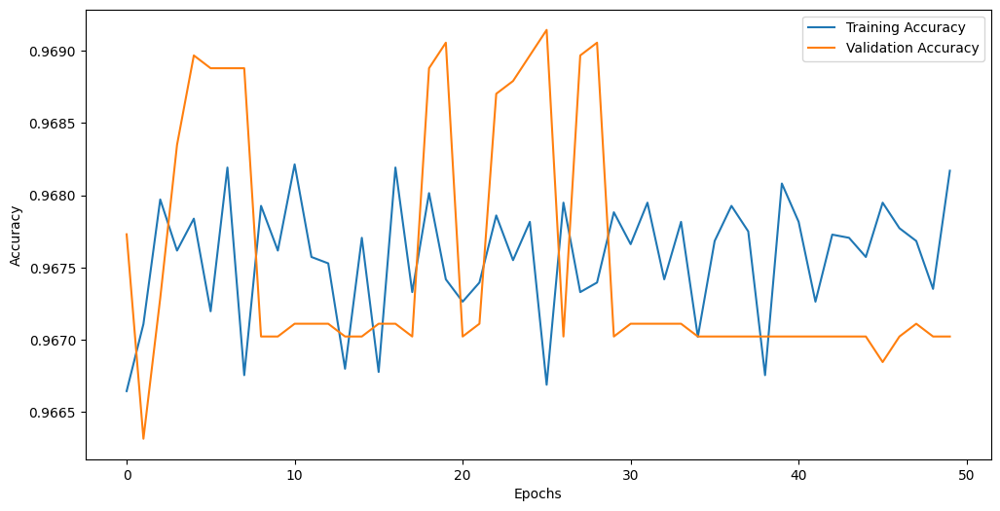

In [33]:
# Visualisasi Training History
plt.figure(figsize=(12, 6))
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

In [34]:
# Prediksi pada data test
y_pred = model.predict(X_test)
y_pred = (y_pred > 0.5).astype(int)  # Mengubah prediksi menjadi 0 atau 1

cm = confusion_matrix(y_test, y_pred)

442/442 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step


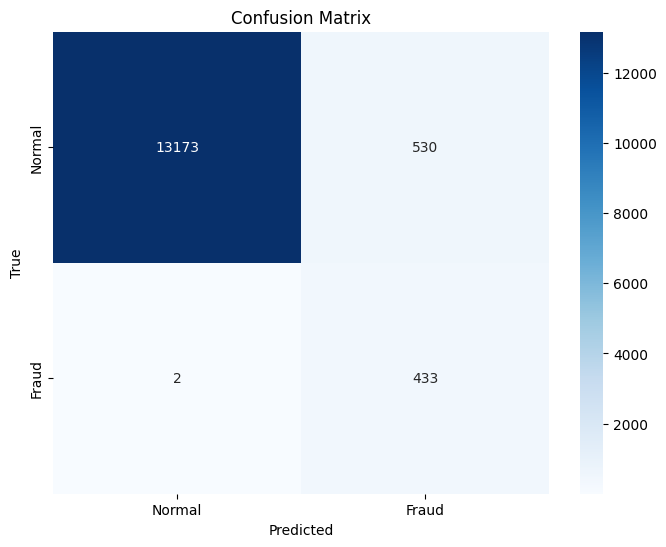

In [35]:
# Visualisasi confusion matrix dengan heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=['Normal', 'Fraud'], yticklabels=['Normal', 'Fraud'])
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()